# Cadence groups for Time Domain Science



In [1]:
from os import path, getcwd
from sys import path as pythonpath
pythonpath.append(path.join(getcwd(), '..'))
import config_utils
import survey_footprints
import regions
import healpy as hp
from mw_plot import MWSkyMap, MWSkyMapBokeh
from astropy_healpix import HEALPix
from astropy import units as u
from astropy.coordinates import Galactic, TETE, SkyCoord, ICRS
from astropy.table import Table, Column
import numpy as np
from sklearn.cluster import KMeans
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import json
from os import path
%matplotlib inline


# Configure path to local repository
root_dir = '/Users/rstreet/software/rgps'

# HEALpixel grid resolution
NSIDE = 64
PIXAREA = hp.nside2pixarea(NSIDE, degrees=True)

## Set up

In [2]:
sim_config = config_utils.read_config(path.join(getcwd(), '..', 'config', 'sim_config.json'))

In [3]:
science_cases = config_utils.read_config(path.join(root_dir, 'config', 'rgps_science_cases.json'))

In [4]:
time_domain_science = {author: info for author, info in science_cases.items() if info['time_domain']}

## Cadence Groups 

A range of authors proposed similar cadence for a variety of reasons

In [5]:
# Proposals with <1hr cadence
# Kupfer asks to rotate around ~6 pointings continuously for ~8hrs.  For this to be efficient, the pointings 
# need to be close together on sky to minimize slews
# Science: Flares, stellar transients, high-speed, CVs, YSO variability
cadence_group1 = [
    'Kupfer', 'Morihana2', 'Rich2', 'Bonito', 'Pardo'
]
#cadence_group1 = ['Pardo']
# Proposals with multi-hour cadence
# SFR variability, AGN jets, X-ray binaries
cadence_group2 = [
    'Paladini2', 'DAmmando', 'Bahramian'
]
cadence_group2 = [
    'Paladini2', 'DAmmando'
]
# Proposals with multi-day cadence 
# RR Lyrae
cadence_group3 = [
    'Freeman', 'Navarro', 
]

# Remaining proposals:
# Kuiper Belt
other = [
    'Benecchi1'
]

In [6]:
science_regions = regions.load_regions_from_file(sim_config,
                                                         path.join(root_dir, 'region_data', 'rgps_science_regions_time_domain.json'))

In [7]:
def merge_regions(sim_config, region_data, case_list):

    # Compile a list of regions for this optic over all science cases 
    region_list = []
    region_names = []
    
    for optic in sim_config['OPTICAL_COMPONENTS']: 

        for author in case_list:
            # Not all authors produced valid regions
            if author in region_data.keys():
                params = region_data[author]
                
                if optic in params.keys():
        
                    # Do not duplicate a region if an author has requested it for multiple filters
                    for r in params[optic]:
                        if r.name not in region_names:
                            region_list.append(r)
                            region_names.append(r.name)
    
    if len(region_list) > 0:
        r_merge = regions.combine_regions(region_list)
        r_merge.optic = 'ALL'
        r_merge.label = 'Merged survey footprint'
    else:
        r_merge = None 
        
    return r_merge

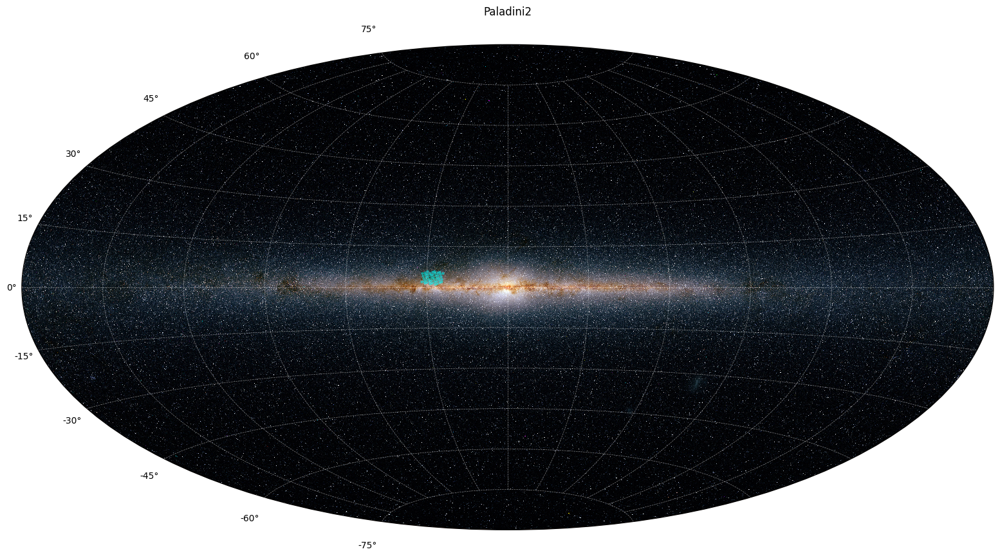

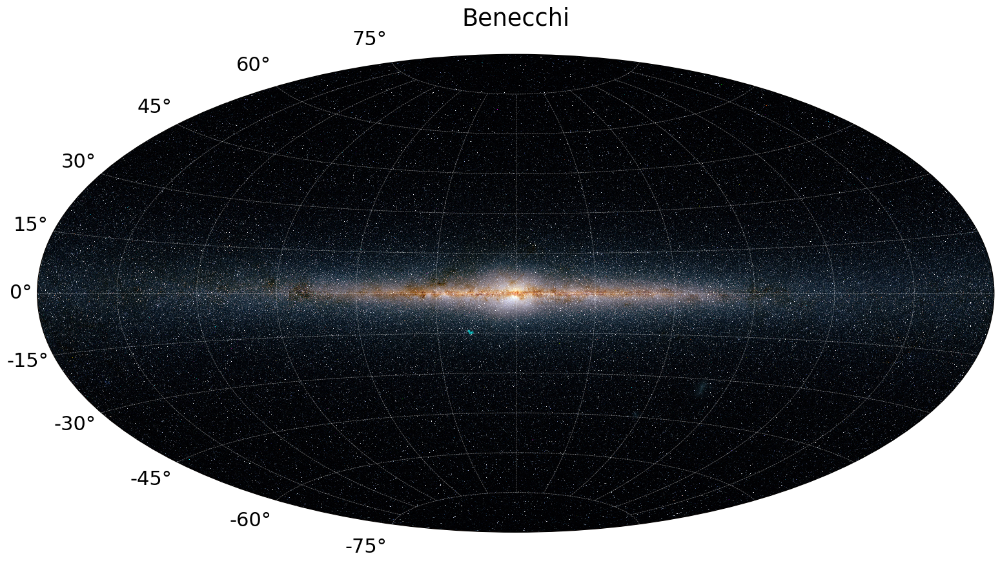

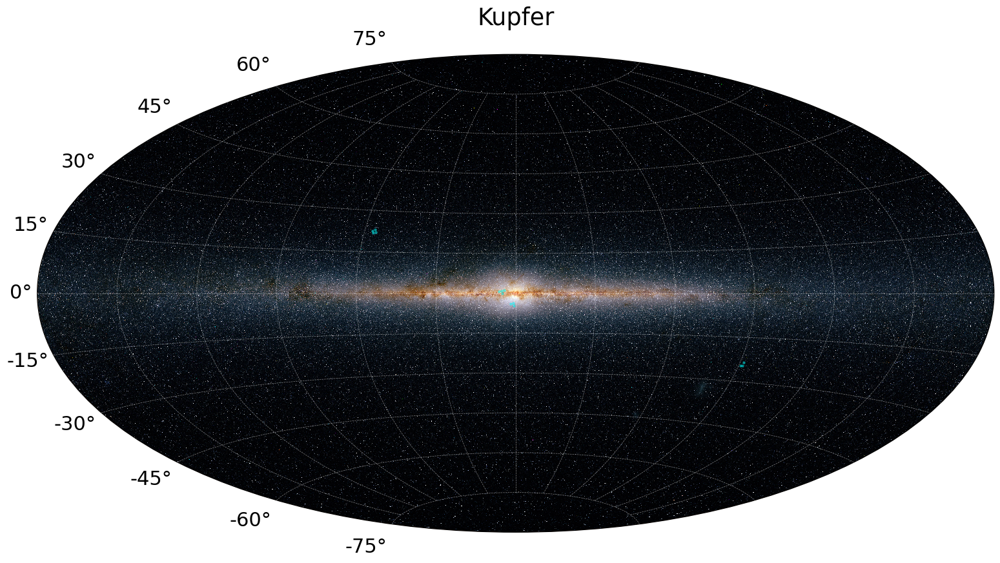

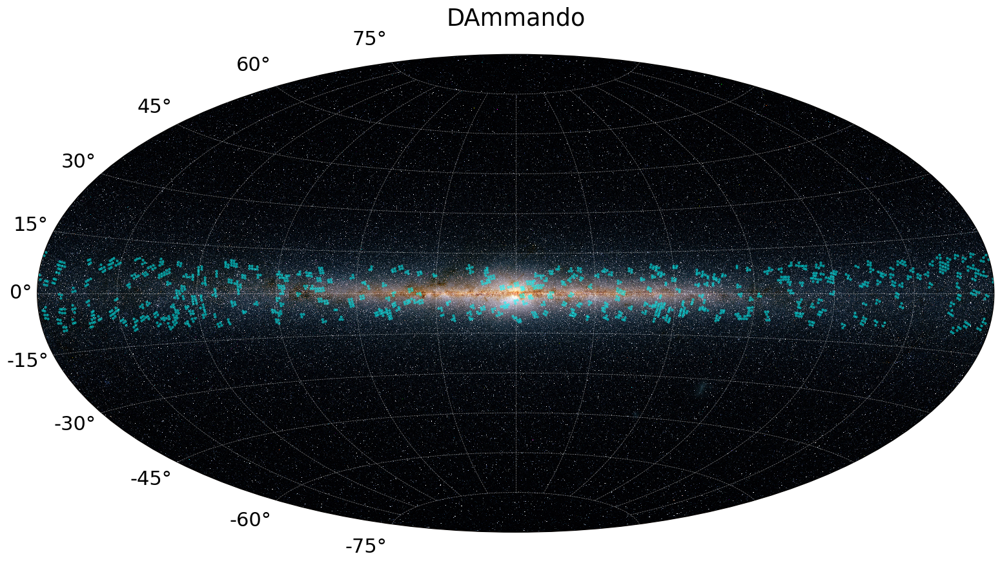

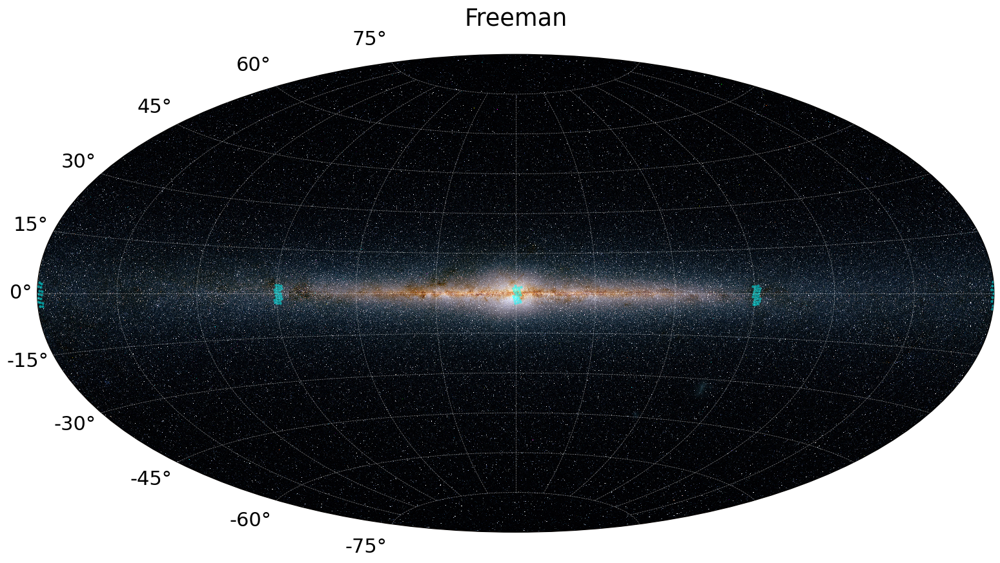

...

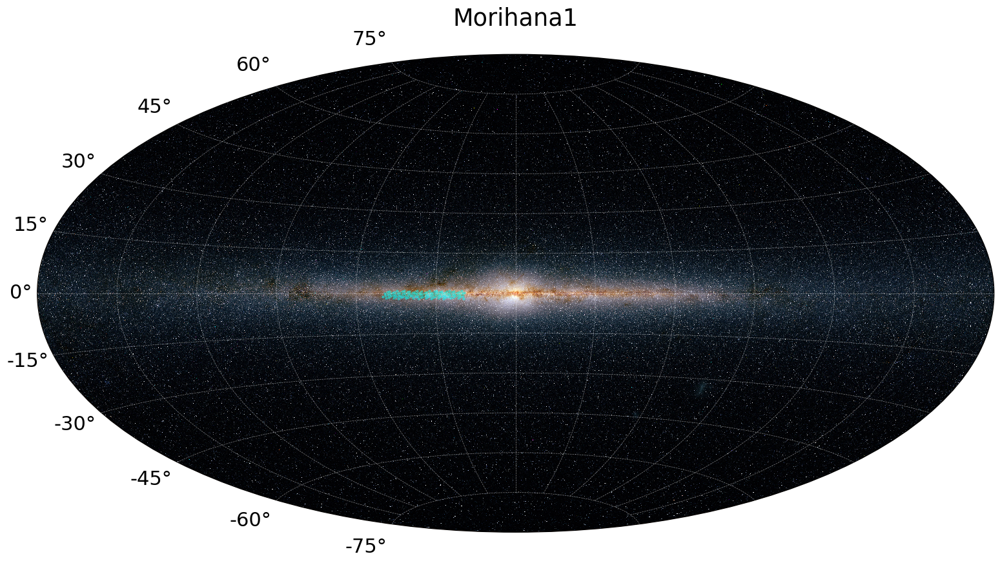

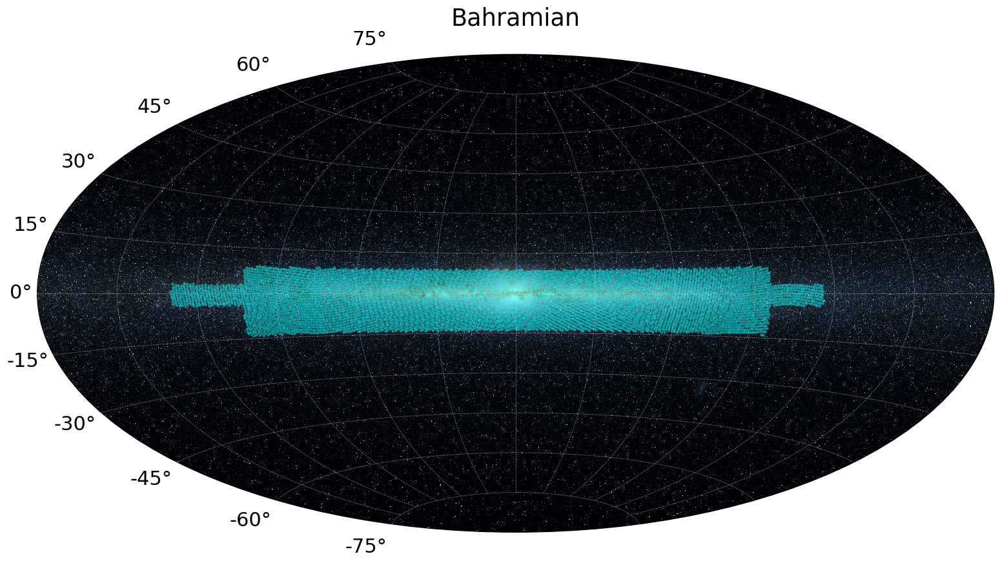

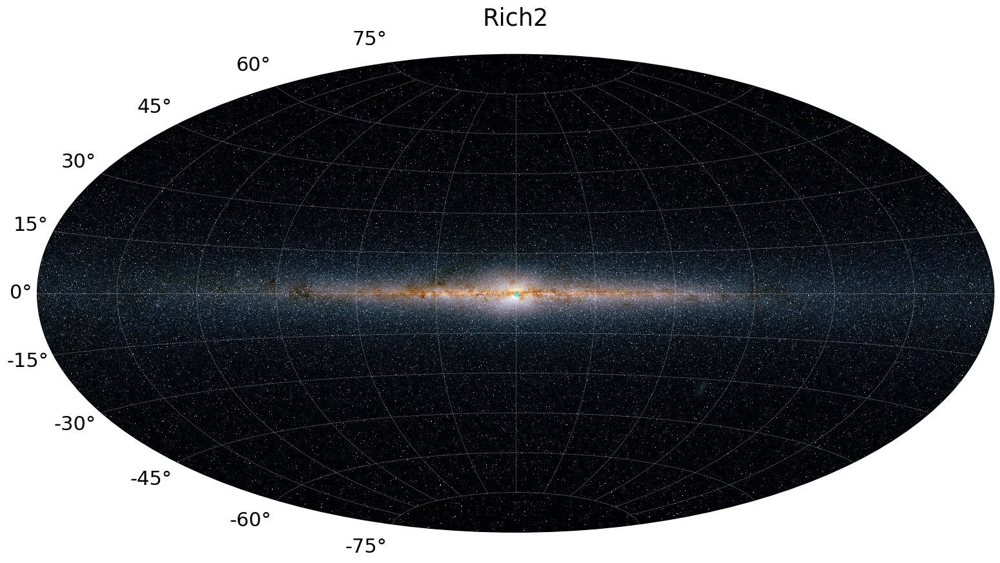

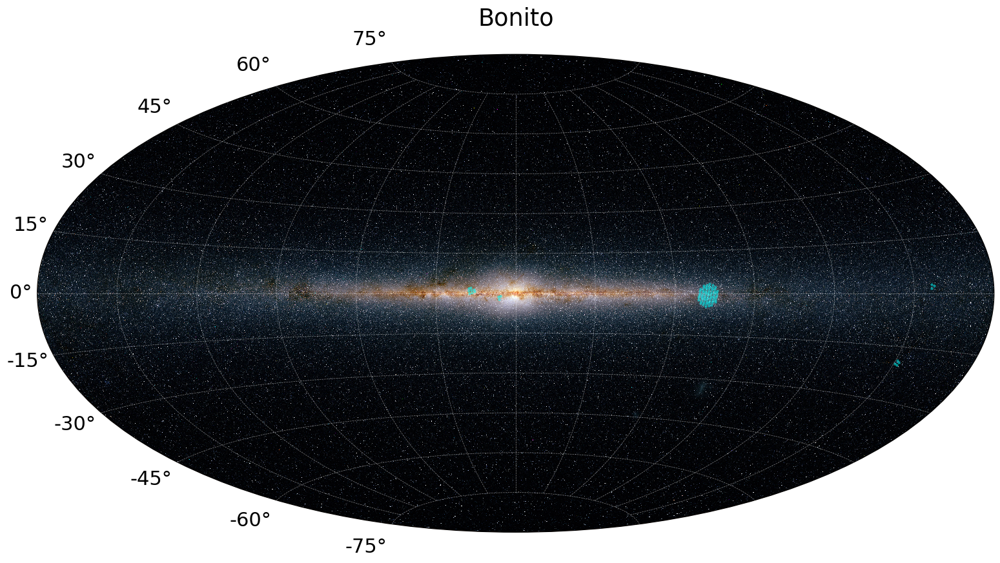

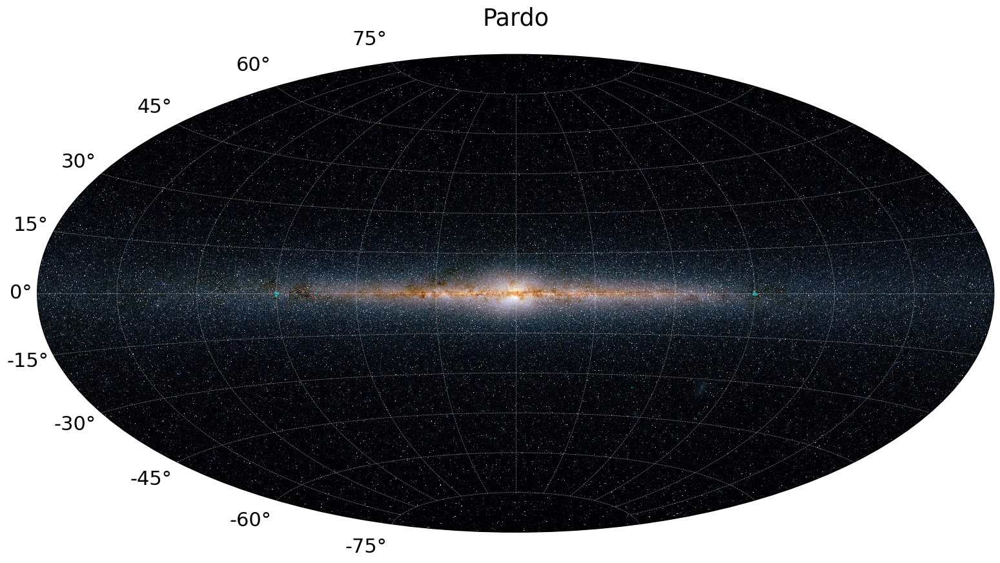

In [8]:
# Output plots of the regions requested for all time domain proposals 
for author, params in time_domain_science.items():
    r_merge = merge_regions(sim_config, science_regions, [author])
    if r_merge:
        mw1 = MWSkyMap(projection='aitoff', grayscale=False, grid='galactic', background='infrared', figsize=(16, 10))
        mw1.title = author
        s = r_merge.pixels_to_skycoords()
        #mw1.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c=r_merge.region_map[r_merge.pixels], cmap='Blues', s=5, alpha=0.4)
        mw1.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c='cyan', s=5, alpha=0.4)
        plt.rcParams.update({'font.size': 22})
        plt.tight_layout()
        plt.savefig(path.join(root_dir, 'time_domain_science', author+'_requested_regions_map.png'))


We can plot plot combined maps of regions requesting similar cadences of observations.

In [10]:
region_group1 = merge_regions(sim_config, science_regions, cadence_group1)
region_group2 = merge_regions(sim_config, science_regions, cadence_group2)
region_group3 = merge_regions(sim_config, science_regions, cadence_group3)

In [ ]:
# Group 1: <1 hr cadence observations
mw2 = MWSkyMap(projection='aitoff', grayscale=False, grid='galactic', background='infrared', figsize=(16, 10))
mw2.title = 'Group 1: <1 hr cadence'
s = region_group1.pixels_to_skycoords()
mw2.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c=region_group1.region_map[region_group1.pixels], cmap='Blues', s=5, alpha=0.4)
#mw2.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c='cyan', s=5, alpha=0.4)
plt.rcParams.update({'font.size': 22})
plt.tight_layout()
plt.savefig(path.join(root_dir, 'time_domain_science', 'cadence_group1_regions_map.png'))

Two regions stand out for high-cadence observations: the central nuclear stellar disk fields and a subregion of the Subaru survey region. 

In both cases, these 'hot spots' occur because the authors requested multiple regions within the same proposal, and those regions overlap, effectively giving those spots additional weight for a single science case, but not indicating multiple science cases.  

So: we have a large number of potential regions for high-cadence observations and we can't do them all.  
Choosing a set that are close together so that we can rotate between them is a justifiable way of covering different stellar environments while minimising slew time.  

In [ ]:
# Group 2: multi-hour cadence observations
mw3 = MWSkyMap(projection='aitoff', grayscale=False, grid='galactic', background='infrared', figsize=(16, 10))
mw3.title = 'Group 2: multi-hour cadence'
s = region_group2.pixels_to_skycoords()
mw3.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c=region_group2.region_map[region_group2.pixels], cmap='Blues', s=5, alpha=0.4)
plt.rcParams.update({'font.size': 22})
plt.tight_layout()
plt.savefig(path.join(root_dir, 'time_domain_science', 'cadence_group_2_regions_map.png'))


This map is dominated by the very large regions requested by Bahramian (essentially the entire Galactic Plane) and the large AGN catalog of D'Ammando.  Both authors indicated that observations anywhere in these footprints would be valuable.  

There is no overlap between the D'Ammando catalog and the footprint requested by Paladini (W40/Serpens region), likely due to foreground extinction excluding detections of AGN.  

So here again there are no obvious synergies between science cases for intermediate cadence. 

In [ ]:
# Group 3: long cadence observations
mw4 = MWSkyMap(projection='aitoff', grayscale=False, grid='galactic', background='infrared', figsize=(16, 10))
mw4.title = 'Group 3: long cadence'
s = region_group3.pixels_to_skycoords()
mw4.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c=region_group3.region_map[region_group3.pixels], cmap='Blues', s=5, alpha=0.4)
plt.rcParams.update({'font.size': 22})
plt.tight_layout()
plt.savefig(path.join(root_dir, 'time_domain_science', 'cadence_group_3_regions_map.png'))


There is overlap between the footprints requested for long-timescale, low-cadence observations in the Galactic center region, thanks to complementary regions requested for microlensing and RR Lyrae. 

## Filter Preferences for Time Domain Science